In [1]:
import matplotlib.pyplot as plt
from scipy.io import wavfile
import numpy as np
import scipy.io, math
import pandas as pd
import IPython.display as ipd

In [2]:
paths = ['data/1_prelude.wav', 'data/2_love_is_blue.wav', 'data/3_chanson_du_toreador.wav', 'data/4_el_bimbo.wav']

In [3]:
ipd.Audio(paths[0])

In [4]:
ipd.Audio(paths[1])

In [5]:
ipd.Audio(paths[2])

In [6]:
ipd.Audio(paths[3])

In [7]:
def plot(audio, rate):

    plt.subplot(211)
    plt.plot(audio)
    plt.xlabel('Sample')
    plt.ylabel('Amplitude')
    plt.figure(figsize = (10, 10))

    plt.subplot(212)
    plt.specgram(audio, Fs = rate, cmap="jet")
    plt.colorbar()
    plt.xlabel('Time')
    plt.ylabel('Frequency')
    plt.figure(figsize = (10, 10))
               
    plt.show()

In [100]:
def removeHighOrLowFreq(splited, frame, min_freq = 100, max_freq = 5000):
    sft = []
    
    s_freq = math.floor(min_freq / frame)
    f_freq = math.floor(max_freq / frame)
    
    for i in range(len(splited)):
        ft = np.fft.fft(splited[i])
        sft.append(np.array(ft[s_freq:f_freq]))
        
    return pd.DataFrame(np.array(sft).T)

In [101]:
def getNoisePrint(path, window_size = 2048, split = 6):
    sample_rate, sample = wavfile.read(path, mmap=False)
    plot(sample, sample_rate)
    
    frame = sample_rate / window_size
    sample = sample[:math.floor(sample.shape[0] / window_size) * window_size]
    splited = np.split(sample,len(sample) / window_size)
    
    t = np.arange(window_size)
    
    sft = removeHighOrLowFreq(splited, frame)
    sft_sets = np.split(sft, split)
    noise = []
    
    for i in range(split):
        noise.append(sft_sets[i].idxmax())
    
    return noise

C:\Users\Negar\AppData\Local\Programs\Python\Python38-32\lib\site-packages\matplotlib\axes\_axes.py:7702: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


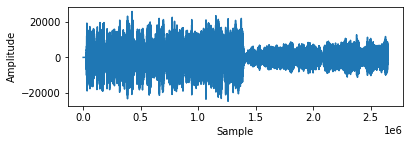

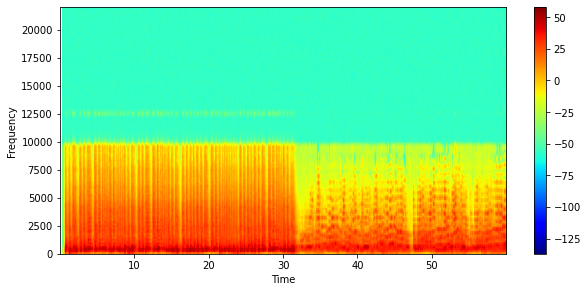

<Figure size 720x720 with 0 Axes>

In [102]:
noisePrint_set = []
noisePrint_set.append(np.array(getNoisePrint(paths[0])))

C:\Users\Negar\AppData\Local\Programs\Python\Python38-32\lib\site-packages\matplotlib\axes\_axes.py:7702: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


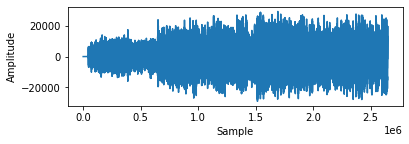

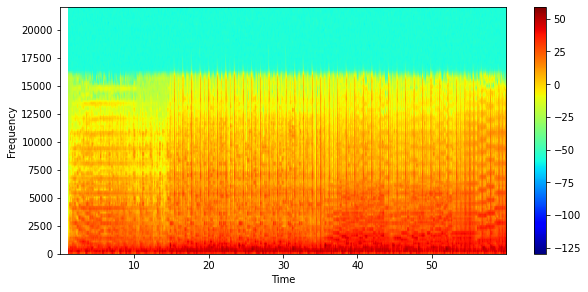

<Figure size 720x720 with 0 Axes>

In [86]:
noisePrint_set.append(np.array(getNoisePrint(paths[1])))

C:\Users\Negar\AppData\Local\Programs\Python\Python38-32\lib\site-packages\matplotlib\axes\_axes.py:7702: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


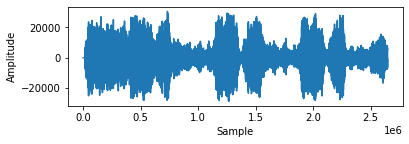

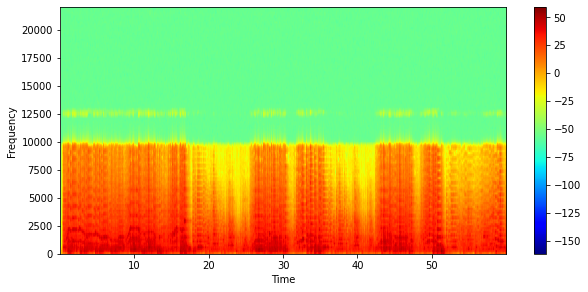

<Figure size 720x720 with 0 Axes>

In [87]:
noisePrint_set.append(np.array(getNoisePrint(paths[2])))

C:\Users\Negar\AppData\Local\Programs\Python\Python38-32\lib\site-packages\matplotlib\axes\_axes.py:7702: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


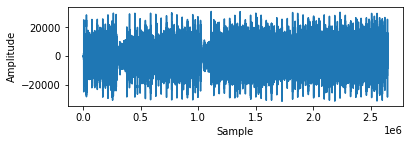

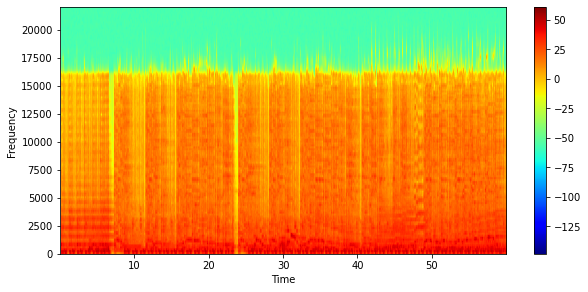

<Figure size 720x720 with 0 Axes>

In [88]:
noisePrint_set.append(np.array(getNoisePrint(paths[3])))

In [89]:
def similarity(song_spec, clip_spec, points_per_slice=6):    
    song_flat = song_spec.flatten()
    clip_flat = clip_spec.flatten()
    
    sim_window_size = points_per_slice - 1
    score = 0
    for anchor in range(clip_flat.shape[0] - points_per_slice):
        anchor_y = anchor % points_per_slice
        sim_window = clip_flat[anchor: anchor+sim_window_size]
        for song_anchor in range(anchor_y, song_flat.shape[0] - points_per_slice - 1, points_per_slice):
            if clip_flat[anchor] == song_flat[song_anchor]:
                if np.count_nonzero((song_flat[song_anchor:song_anchor+sim_window_size] - sim_window) == 0) >= 4:
                    score += 1
    
    score /= song_flat.shape[0]
    return score

In [90]:
def checkSong(path):
    inputNoisePrint = np.array(getNoisePrint(path))

    res = [0.0 , 0.0 , 0.0 , 0.0]
    
    res[0] = similarity(noisePrint_set[0], inputNoisePrint)
    res[1] = similarity(noisePrint_set[1], inputNoisePrint)
    res[2] = similarity(noisePrint_set[2], inputNoisePrint)
    res[3] = similarity(noisePrint_set[3], inputNoisePrint)

    print(res)
    
    most = 0.0
    index = 0
    
    for i in range(0,4):
        if most < res[i]:
            most = res[i]
            index = i
            
    return index

In [91]:
ipd.Audio("clip/clip1.wav")

C:\Users\Negar\AppData\Local\Programs\Python\Python38-32\lib\site-packages\matplotlib\axes\_axes.py:7702: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


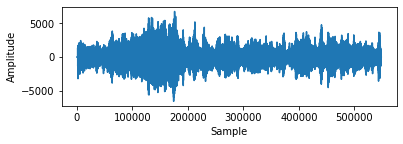

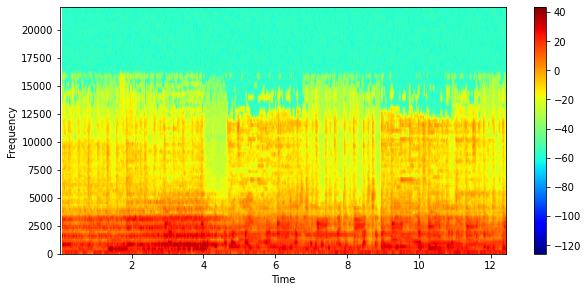

<Figure size 720x720 with 0 Axes>

[0.001549186676994578, 0.0011618900077459333, 0.0003872966692486445, 0.004002065582235993]
similar to : data/4_el_bimbo.wav


In [92]:
res = checkSong("clip/clip1.wav")
print('similar to : ' + paths[res])

In [93]:
ipd.Audio("clip/clip2.wav")

C:\Users\Negar\AppData\Local\Programs\Python\Python38-32\lib\site-packages\matplotlib\axes\_axes.py:7702: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


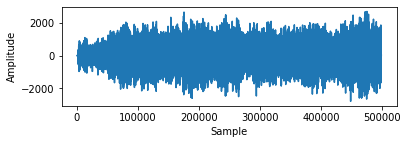

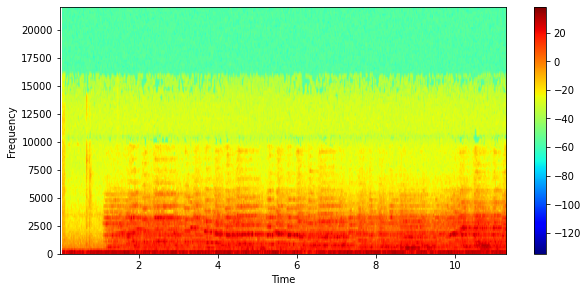

<Figure size 720x720 with 0 Axes>

[0.0024528789052414147, 0.001678285566744126, 0.0018073844564936742, 0.000774593338497289]
similar to : data/1_prelude.wav


In [94]:
res = checkSong("clip/clip2.wav")
print('similar to : ' + paths[res])

In [95]:
ipd.Audio("clip/clip3.wav")

C:\Users\Negar\AppData\Local\Programs\Python\Python38-32\lib\site-packages\matplotlib\axes\_axes.py:7702: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


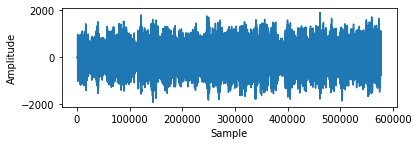

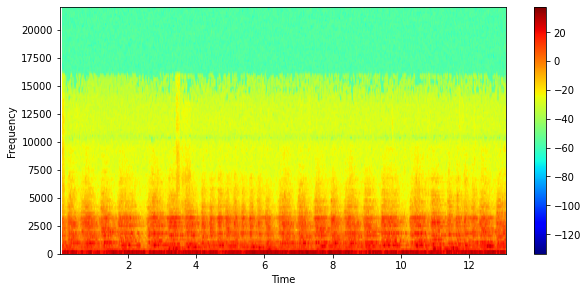

<Figure size 720x720 with 0 Axes>

[0.008004131164471986, 0.002581977794990963, 0.001549186676994578, 0.0011618900077459333]
similar to : data/1_prelude.wav


In [96]:
res = checkSong("clip/clip3.wav")
print('similar to : ' + paths[res])